In [1]:
# import boto3
import pdal
import json
import sys
import geopandas as gpd
from shapely.geometry import Polygon
from shapely.geometry import Point
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits import mplot3d


In [4]:
s3 = boto3.resource("s3")
s3_bucket = s3.Bucket('usgs-lidar-public')

In [6]:
# files_in_s3 = [f.key for f in s3_bucket.objects]


In [2]:
import geopandas as gpd
from shapely.geometry import Polygon

MINX, MINY, MAXX, MAXY = [-93.756155, 41.918015, -93.747334, 41.921429]
polygon = Polygon(((MINX, MINY), (MINX, MAXY),
                  (MAXX, MAXY), (MAXX, MINY), (MINX, MINY)))

grid = gpd.GeoDataFrame([polygon], columns=["geometry"])
# grid.set_crs(epsg=4326, inplace=True)


In [118]:
s2 = gpd.GeoDataFrame([Point(-93.75, 41.919),
                       Point(0, 0),
                       Point(0, 1), ], columns=["geometry"])
s2.set_crs(epsg=4326, inplace=True)

,geometry
0,POINT (-93.75000 41.91900)
1,POINT (0.00000 0.00000)
2,POINT (0.00000 1.00000)


In [121]:
# s2[grid.geometry.contains(s2.geometry)]
polygon.contains(Point(-93.756155, 41.918015))


False

In [6]:
new_polygon = Polygon(((15,20),(16,21),(18,22),(29,22),(15,20)))

In [14]:
MINX, MINY, MAXX, MAXY = new_polygon.bounds
MAXY

22.0

In [4]:
df = DataFetcher(polygon=polygon, region="IA_FullState", epsg="4326")

In [8]:
df.construct_pipeline('farm_new', window_size=1, resolution=1)

In [9]:
df.get_data()

In [5]:
df.construct_simple_pipeline(sampling_raidus=2)


In [6]:
df.get_data()

In [9]:
len(df.get_pipeline_arrays()[0])

66896

In [7]:
df.construct_elevation_geodf()

In [21]:
df.elevation_geodf.head()

,elevation,geometry
0,313.52,POINT (-93.75382 41.91808)
1,314.09,POINT (-93.75372 41.91810)
2,313.14,POINT (-93.75432 41.91808)
3,311.29,POINT (-93.75511 41.91802)
4,313.87,POINT (-93.75373 41.91816)


<Figure size 1000x1500 with 0 Axes>

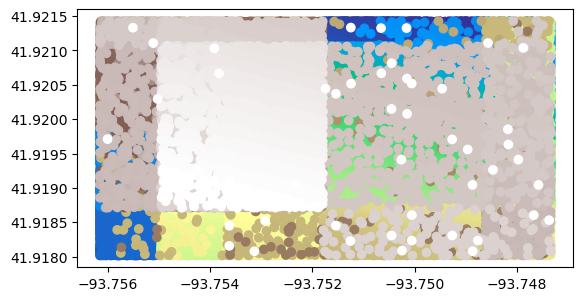

In [8]:
plt.figure(figsize=(10, 15))
# ax = plt.axes(projection='2d')

df.elevation_geodf.plot(c='elevation', cmap='terrain', legend=True)
# plt.xlabel('Longitude')
# plt.ylabel('Latitude')
# plt. zlabel('Elevation Heat-Map')
plt.show()


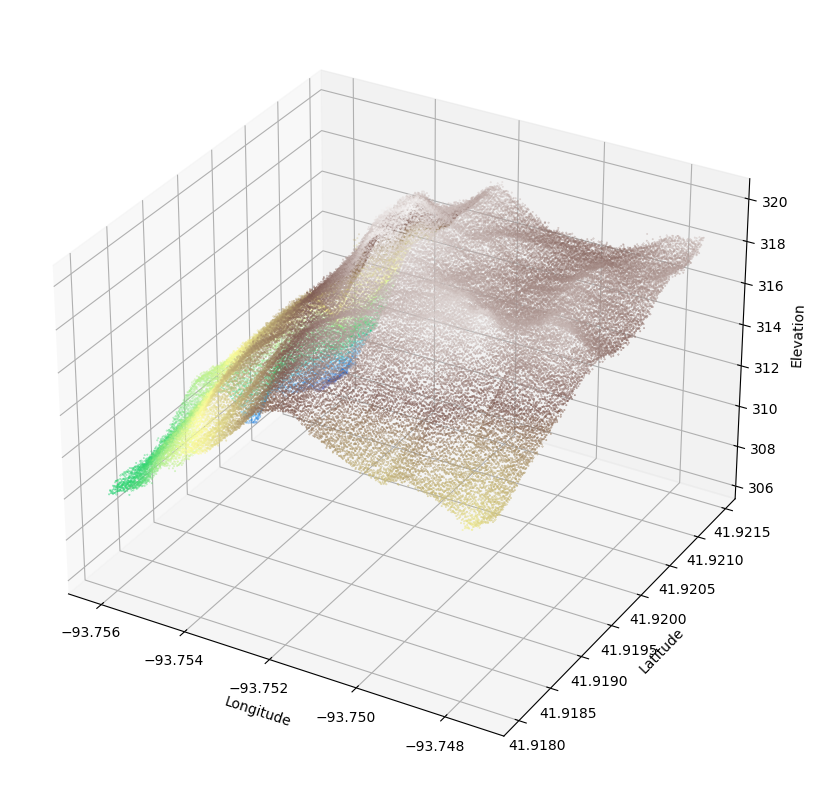

In [34]:
df.draw_basic()

In [15]:
arr = df.get_pipeline_arrays()

In [16]:
len(arr[0])

19731

In [8]:
df.elevation_geodf()

In [9]:
df.elevation_geodf.sample(10)

,elevation,geometry
221833,318.45,POINT (-93.75138 41.91976)
274778,314.86,POINT (-93.75433 41.92062)
122731,316.88,POINT (-93.74912 41.91869)
95031,316.53,POINT (-93.75376 41.92013)
109567,309.52,POINT (-93.75556 41.92091)
200528,317.43,POINT (-93.74948 41.92019)
72816,315.30,POINT (-93.74765 41.91855)
263826,316.60,POINT (-93.75384 41.91967)
17342,317.50,POINT (-93.75032 41.92038)
397064,317.37,POINT (-93.74763 41.91980)


In [10]:
elevation = df.elevation_geodf

In [11]:
a = df.get_pipeline_arrays()

In [12]:
 values = []
 for row in df.get_pipeline_arrays()[0]:
    lst = row.tolist()[-3:]
    values.append(lst)


In [13]:
import numpy as np
values = np.array(values)

In [14]:
values.shape

(401577, 3)

In [15]:
values = values[::10]

In [16]:
values.shape

(40158, 3)

In [36]:
%matplotlib notebook

In [37]:
fig = plt.figure(figsize=(10,15))
ax = plt.axes(projection='3d')

ax.scatter3D(values[:, 0], values[:, 1],
           values[:, 2], c=values[:, 2], s=0.1, cmap='terrain')

ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
ax.set_zlabel('Elevation')

# ax.view_init(0,0)

plt.show()

<IPython.core.display.Javascript object>

In [187]:
elevation.plot()

<AxesSubplot:>